<a href="https://colab.research.google.com/github/RivkyTR/alz/blob/main/Part5_Training_best_features.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##**for best features**

In [ ]:
X_train, X_test, y_train, y_test = best_features_df_train, best_features_df_test, best_features_group_train, best_features_group_test

####**Regression**

In [ ]:
model = LogisticRegression()

model.fit(X_train, y_train)
predictions = model.predict(X_test)
accuracy = accuracy_score(y_test, predictions)
report = classification_report(y_test, predictions)
print("Accuracy:", accuracy)
print("\nClassification Report:\n", report)

Accuracy: 0.7837837837837838

Classification Report:
               precision    recall  f1-score   support

           0       0.74      0.86      0.79        36
           1       0.84      0.71      0.77        38

    accuracy                           0.78        74
   macro avg       0.79      0.79      0.78        74
weighted avg       0.79      0.78      0.78        74



The logistic regression model gives us a relatively small percentage of success, we only got an accuracy of 78 percent. We think that the reason is that the true relationship is non-linear.

Logistic Regression assumes a linear relationship between the features and the log-odds of the target variable. If the true relationship is non-linear, Logistic Regression may struggle to capture it.
so we will use a more complex model, like a Random Forest and a Gradient Boosting model, which can capture non-linear relationships more effectively.

Besides, we want to check if there isn't overfitting because we don't have big data, so we will use cross-validation techniques to get a more reliable estimate of the model's performance. This helps ensure that the model's performance is consistent across different subsets of the data.

In [ ]:
model = LogisticRegression()
X = best_features_df.drop(columns=['Group'])
y = best_features_df['Group']

n_splits = 4
skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=0)

cv_scores = cross_val_score(model, X, y, cv=skf)
mean_cv_score = cv_scores.mean()
std_cv_score = cv_scores.std()

print("Cross-validation Scores:", cv_scores)
print(f"Mean Cross-validation Score: {mean_cv_score}")
print(f"Standard Deviation of Cross-validation Scores: {std_cv_score}")

Cross-validation Scores: [0.82608696 0.75       0.80434783 0.74725275]
Mean Cross-validation Score: 0.7819218824653608
Standard Deviation of Cross-validation Scores: 0.034184909793091314


The accuracy remains exactly the same so it seems that the main problem is not overfitting. But the model is too simple.

We will check using a visual graph the differences between accuracy in test data and accuracy in training data.

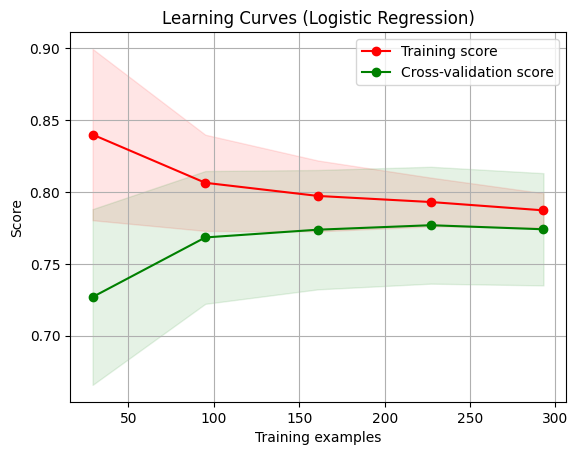

In [ ]:
title = "Learning Curves (Logistic Regression)"
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)
estimator = LogisticRegression(max_iter=1000)
plot_learning_curve(estimator, title, X, y, type_label="Cross-validation score", cv=cv, n_jobs=-1)
plt.show()

We get a distance between the accuracy of the test data and the accuracy of the training data, but it doesn't seem like a very big distance (maybe that's why cross-validation didn't improve the accuracy) so it's more reasonable to assume that the main problem is not overfitting. But the model is too simple.

We will use stronger algorithms.

####**XGBoost Classifier**

In [ ]:
model = xgb.XGBClassifier(n_estimators=150, learning_rate=0.1, random_state=42)
model.fit(X_train, y_train)

#train
train_predictions = model.predict(X_train)
train_accuracy = accuracy_score(y_train, train_predictions)

#test
test_predictions = model.predict(X_test)
test_accuracy = accuracy_score(y_test, test_predictions)
test_report = classification_report(y_test, test_predictions)

print("Training Accuracy:", train_accuracy)
print("Test Accuracy:", test_accuracy)
print("\nTest Classification Report:\n", test_report)

Training Accuracy: 0.9931740614334471
Test Accuracy: 0.8513513513513513

Test Classification Report:
               precision    recall  f1-score   support

           0       0.86      0.83      0.85        36
           1       0.85      0.87      0.86        38

    accuracy                           0.85        74
   macro avg       0.85      0.85      0.85        74
weighted avg       0.85      0.85      0.85        74



We got higher accuracy than the regression, so the assumption that the relationships are not linear is probably correct.

But it is still too low.

let's see if there is overfitting.

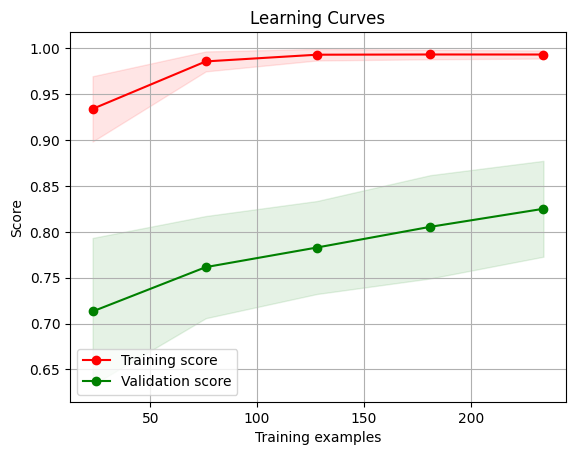

In [ ]:
title = "Learning Curves"
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)
plot_learning_curve(model, title, X_train, y_train, type_label="Validation score", cv=cv, n_jobs=-1)
plt.show()

We got a very problematic overmatch. We will try to solve this in several ways:



1.   Limiting the depth of the tree - did not work
2.   Increasing the minimum child weight - did not work
3.  Early stop - did not work
4. Regulation - did not work
5. cross-validation - did not help
6. Reducing the complexity of the model, i.e. reducing the number of features.





With the help of shap we will find the least significant feature and try to run XGBoost without it.

[08:39:45] WARNING: /workspace/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.


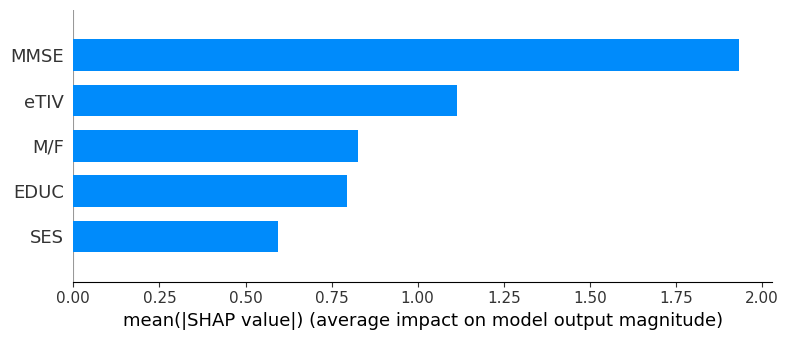

In [ ]:
explainer = shap.Explainer(model)
shap_values = explainer(X_test)
shap.summary_plot(shap_values, X_test, plot_type="bar")

According to the histogram, the feature that has the least effect is **SES**, so we will try to download it and run without it, maybe we will get an improvement in the results and overfitting.

In [ ]:
X_train_xg = X_train.drop(columns=['SES'])
X_test_xg = X_test.drop(columns=['SES'])

In [ ]:
model = xgb.XGBClassifier(n_estimators=150, learning_rate=0.1, random_state=42)
model.fit(X_train_xg, y_train)

# train
train_predictions = model.predict(X_train_xg)
train_accuracy = accuracy_score(y_train, train_predictions)

# test
test_predictions = model.predict(X_test_xg)
test_accuracy = accuracy_score(y_test, test_predictions)
test_report = classification_report(y_test, test_predictions)

print("Training Accuracy:", train_accuracy)
print("Test Accuracy:", test_accuracy)
print("\nTest Classification Report:\n", test_report)

Training Accuracy: 0.9897610921501706
Test Accuracy: 0.8648648648648649

Test Classification Report:
               precision    recall  f1-score   support

           0       0.82      0.92      0.87        36
           1       0.91      0.82      0.86        38

    accuracy                           0.86        74
   macro avg       0.87      0.87      0.86        74
weighted avg       0.87      0.86      0.86        74



We got an improvement of about 1.3 percent.

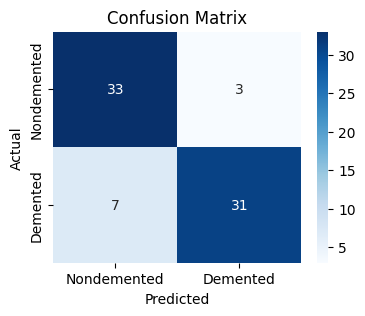

In [ ]:
conf_matrix = confusion_matrix(y_test, test_predictions)
plt.figure(figsize=(4, 3))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Nondemented', 'Demented'],
            yticklabels=['Nondemented', 'Demented'])

plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

 But as we'll see in the next graph, overfitting doesn't seem to have improved much...

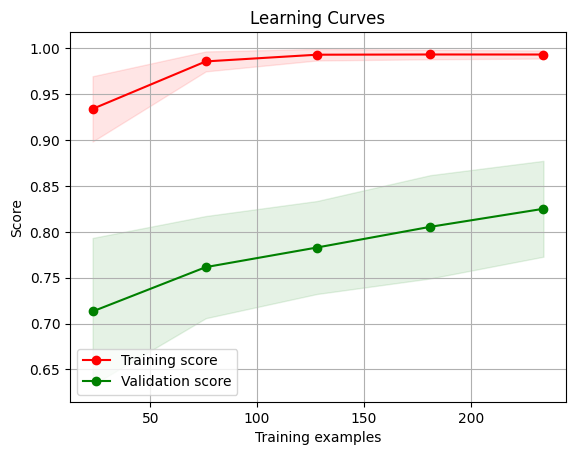

In [ ]:
title = "Learning Curves"
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)
plot_learning_curve(model, title, X_train, y_train, type_label="Validation score", cv=cv, n_jobs=-1)
plt.show()

Random Forest is generally less prone to overfitting compared to XGBoost. If overfitting is a concern, Random Forest may perform better results.

####**Random Forest Classifier**


Random Forest is also an ensemble learning method, but it operates differently from gradient boosting.

It builds multiple decision trees independently and averages their predictions (for regression) or takes a vote (for classification).
Each tree in a random forest is built using a different subset of the data and a random subset of features.
This randomness helps to reduce overfitting.

In [ ]:
model = RandomForestClassifier(n_estimators=150, random_state=42)
model.fit(X_train, y_train)

# train
train_predictions = model.predict(X_train)
train_accuracy = accuracy_score(y_train, train_predictions)

# test
test_predictions = model.predict(X_test)
test_accuracy = accuracy_score(y_test, test_predictions)
test_report = classification_report(y_test, test_predictions)

print("Training Accuracy:", train_accuracy)
print("Test Accuracy:", test_accuracy)
print("\nTest Classification Report:\n", test_report)

Training Accuracy: 0.9965870307167235
Test Accuracy: 0.8783783783783784

Test Classification Report:
               precision    recall  f1-score   support

           0       0.86      0.89      0.88        36
           1       0.89      0.87      0.88        38

    accuracy                           0.88        74
   macro avg       0.88      0.88      0.88        74
weighted avg       0.88      0.88      0.88        74



The accuracy of the training data is 0.99
And the accuracy of the test data is 0.87.

This means that there is a serious overfitting here. We will also see this visually in the following graph.



> ⬇⬇







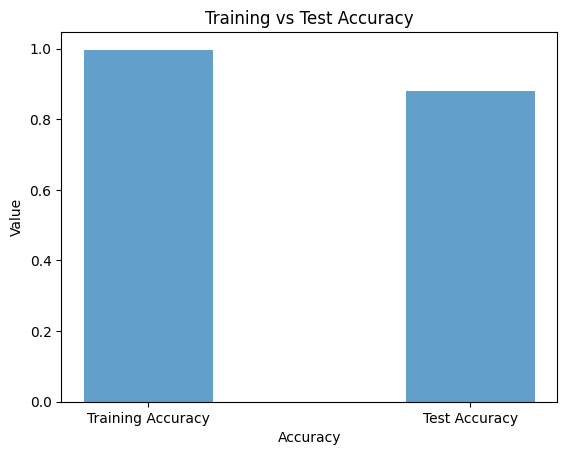

In [ ]:
labels = ['Training Accuracy', 'Test Accuracy']

accuracy_values = [train_accuracy, test_accuracy]

x = np.arange(len(labels))

plt.bar(x, accuracy_values, width=0.4, align='center', alpha=0.7)
plt.xlabel('Accuracy')
plt.ylabel('Value')
plt.title('Training vs Test Accuracy')
plt.xticks(x, labels)
plt.show()



There are several hyperparameters that can be tuned to hopefully optimize its performance. We will use a grid search that includes specifying a grid of hyperparameter values and evaluating the model's performance for each combination of these values. The hyperparameters chosen for testing are:

- n_estimators - the number of trees in the forest. Increasing the number of trees generally improves performance, but unfortunately, it also increases computation time.
- min_samples_split - the minimum number of samples required to split an internal node.
- max_depth - the maximum depth of the trees. This controls the maximum number of levels in each decision tree.
- Criterion - the function to measure the quality of a split



In addition, we will also use cross-validation to minimize the overfitting.

In [ ]:
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 5, 10],
    'min_samples_split': [2, 5, 10],
    'criterion': ['gini', 'entropy']
}

rf_classifier = RandomForestClassifier()

grid_search = GridSearchCV(rf_classifier, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train, y_train)

# the best hyperparameters
best_params = grid_search.best_params_
print("Best Hyperparameters:", best_params)

# Calculate accuracy of the best model on training data and test data
best_model = grid_search.best_estimator_
#train
train_predictions = best_model.predict(X_train)
train_accuracy = accuracy_score(y_train, train_predictions)
#test
test_predictions = best_model.predict(X_test)
test_accuracy = accuracy_score(y_test, test_predictions)
test_report = classification_report(y_test, test_predictions)

print("Training Accuracy:", train_accuracy)
print("Test Accuracy:", test_accuracy)
print("\nTest Classification Report:\n", test_report)

Best Hyperparameters: {'criterion': 'entropy', 'max_depth': 10, 'min_samples_split': 2, 'n_estimators': 50}
Training Accuracy: 0.9931740614334471
Test Accuracy: 0.918918918918919

Test Classification Report:
               precision    recall  f1-score   support

           0       0.89      0.94      0.92        36
           1       0.94      0.89      0.92        38

    accuracy                           0.92        74
   macro avg       0.92      0.92      0.92        74
weighted avg       0.92      0.92      0.92        74



The accuracy of the training data is 99%
And the accuracy of the test data is almost 92%!.

Overfitting has improved.


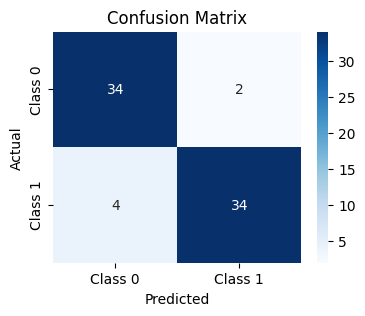

In [ ]:
conf_matrix = confusion_matrix(y_test, test_predictions)
plt.figure(figsize=(4, 3))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Class 0', 'Class 1'],
            yticklabels=['Class 0', 'Class 1'])

plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

We see 4 observations are FN and 2 observations FP. A total of 6 errors.

We would like to find out where he failed and why precisely in these observations. The first thing is to find out which observations were misclassified.

In [ ]:
misclassified_rf_df = pd.DataFrame({
    'X_test': X_test.index,
    'True_Label': y_test,
    'Predicted_Label': test_predictions
})

# Filter out the misclassified instances
misclassified_rf_df = misclassified_rf_df[misclassified_rf_df['True_Label'] != misclassified_rf_df['Predicted_Label']]
misclassified_rf_df.reset_index(drop=True, inplace=True)
print("Misclassified Instances:")
misclassified_rf_df

Misclassified Instances:


,X_test,True_Label,Predicted_Label
0,344,0,1
1,333,1,0
2,109,1,0
3,93,0,1
4,3,1,0
5,73,1,0


We received 6 misclassified observations.

We would like to get the values of the features after normalization (those on which the training was actually done): misclassified_rf_df

In [ ]:
misclassified_rf_df = pd.merge(best_features_df, misclassified_rf_df, left_index=True, right_on='X_test')
misclassified_rf_df.drop(['Group'], axis=1, inplace=True)
misclassified_rf_df

,M/F,MMSE,SES,EDUC,eTIV,X_test,True_Label,Predicted_Label
4,1.169505,0.148345,-0.388346,-0.968661,1.421313,3,1,0
5,1.169505,0.450805,1.438871,-0.968661,-0.012562,73,1,0
3,-0.855063,-0.154114,-0.388346,0.477926,-0.429585,93,0,1
2,-0.855063,0.450805,-1.301954,1.201219,-1.286482,109,1,0
1,1.169505,0.450805,-1.301954,0.477926,2.341050,333,1,0
0,1.169505,0.148345,0.525263,-0.245368,0.118829,344,0,1


In [ ]:
from lime.lime_tabular import LimeTabularExplainer

X_features = best_features_df.drop(columns=['Group'])
feature_names = X_features.columns

explainer = LimeTabularExplainer(X_features.values, mode="classification", feature_names=feature_names, training_labels=best_features_df['Group'])
for i in misclassified_rf_df["X_test"].values:
  print(f"for the instance {i}")
  instance_index = i
  instance_features = X_features.iloc[instance_index].values
  explanation = explainer.explain_instance(instance_features, best_model.predict_proba)
  explanation.show_in_notebook()

for the instance 3


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


for the instance 73


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


for the instance 93


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


for the instance 109


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


for the instance 333


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


for the instance 344


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


MMSE contributed a significant part to the misclassification for 5 out of 7 errors. This is the feature that contributed the most to the incorrect results. The next feature that contributed to the most incorrect results after MMSE is eTIV which in 4 cases out of 7 was one of the causes of the misclassification.

If we knew that these features do not contribute much to the global results, we would consider omitting them. And so maybe manage to improve the results and reduce errors. We will try to see what are the most important features for the overall results and whether MMSE and eTIV are included in them.


We just want to see how much each feature contributed to the model result.

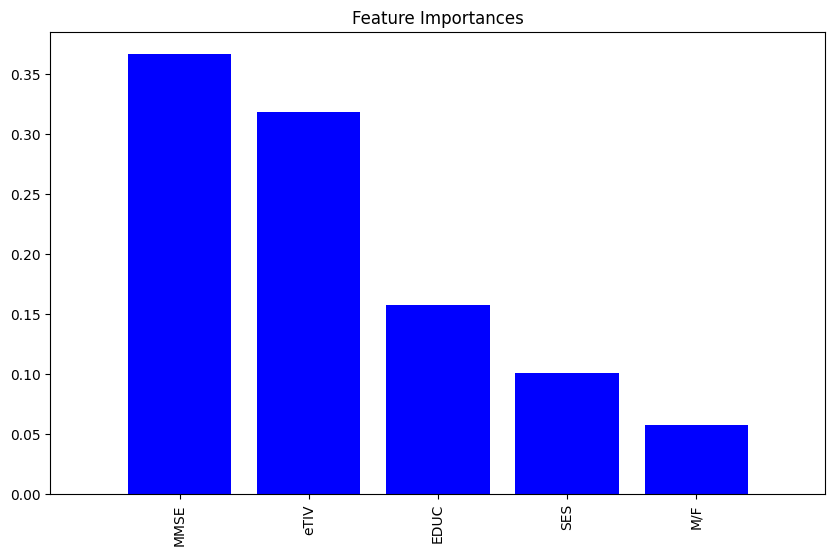

In [ ]:
importances = best_model.feature_importances_

indices = np.argsort(importances)[::-1]

plt.figure(figsize=(6, 4))
plt.title("Feature Importances")
plt.bar(range(X_train.shape[1]), importances[indices],
       color="b", align="center")
plt.xticks(range(X_train.shape[1]), X_train.columns[indices], rotation=90)
plt.xlim([-1, X_train.shape[1]])
plt.show()

In the simulation from the SHAP library it can be seen that the most important features are the features that also contributed to the wrong observations. But if we omit them we will also lose the precision they brought us to.

If so, maybe the problem is with this particular data. Because we see that using MMSE and eTIV features most of the observations were correctly classified. whereas the problem is only with certain observations.

Unsurprisingly, we see that the most impactful features are the features we have already seen in the EDA stages to be the most significant. The MMSE feature is in first place.
In contrast, the subject's gender is less important. (Although he also contributes quite a bit, but in relation to others - less).

####**Neural network with MLPClassifier**

In [ ]:
mlp = MLPClassifier(hidden_layer_sizes=(10, 16), max_iter=500, random_state=55)
mlp.fit(X_train.values, y_train)

y_pred = mlp.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print("Classification Report:")
print(report)

Accuracy: 0.9054054054054054
Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.97      0.91        36
           1       0.97      0.84      0.90        38

    accuracy                           0.91        74
   macro avg       0.91      0.91      0.91        74
weighted avg       0.91      0.91      0.91        74



Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
X has feature names, but MLPClassifier was fitted without feature names


We got a relatively high accuracy of 90 percent.
We will see the results in the confusion matrix:

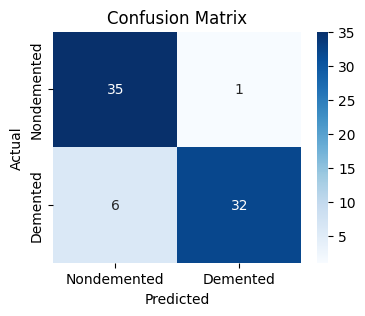

In [ ]:
conf_matrix = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(4, 3))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Nondemented', 'Demented'],
            yticklabels=['Nondemented', 'Demented'])

plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

We see 6 observations are FN and 1 observations FP.
A total of 7 errors.

We would like to find out where he failed and why precisely in these observations.
The first thing is to find out which observations were misclassified.

In [ ]:
misclassified_mlp_df = pd.DataFrame({
    'index': X_test.index,
    'True_Label': y_test,
    'Predicted_Label': y_pred
})

# Filter out the misclassified instances
misclassified_mlp_df = misclassified_mlp_df[misclassified_mlp_df['True_Label'] != misclassified_mlp_df['Predicted_Label']]
misclassified_mlp_df.reset_index(drop=True, inplace=True)
print("Misclassified Instances:")
misclassified_mlp_df

Misclassified Instances:


,index,True_Label,Predicted_Label
0,57,1,0
1,76,1,0
2,196,0,1
3,333,1,0
4,109,1,0
5,277,1,0
6,73,1,0


We received 7 observations.

We would like to get the values of the features after normalization (those on which the training was actually done): misclassified_mlp_df.





In [ ]:
misclassified_mlp_df = pd.merge(best_features_df, misclassified_mlp_df, left_index=True, right_on='index')
misclassified_mlp_df.drop(['Group'], axis=1, inplace=True)
misclassified_mlp_df

,M/F,MMSE,SES,EDUC,eTIV,index,True_Label,Predicted_Label
0,-0.855063,0.753265,0.525263,-0.968661,-0.338183,57,1,0
6,1.169505,0.450805,1.438871,-0.968661,-0.012562,73,1,0
1,-0.855063,-0.456574,-0.388346,1.201219,-1.800621,76,1,0
4,-0.855063,0.450805,-1.301954,1.201219,-1.286482,109,1,0
2,-0.855063,0.148345,0.525263,-0.607015,-1.852034,196,0,1
5,-0.855063,0.450805,-1.301954,0.477926,-0.869459,277,1,0
3,1.169505,0.450805,-1.301954,0.477926,2.341050,333,1,0


We will use LIME (Local Explanations for Model-Agnostic Interpretation) to provide local interpretations of predictions made by the model about misclassified instances.

In [ ]:
from lime.lime_tabular import LimeTabularExplainer

X_features = best_features_df.drop(columns=['Group'])
feature_names = X_features.columns

explainer = LimeTabularExplainer(X_features.values, mode="classification", feature_names=feature_names, training_labels=best_features_df['Group'])
for i in misclassified_mlp_df["index"].values:
  print(f"for the instance {i}")
  instance_index = i
  instance_features = X_features.iloc[instance_index].values
  explanation = explainer.explain_instance(instance_features, mlp.predict_proba)
  explanation.show_in_notebook()

for the instance 57


for the instance 73


for the instance 76


for the instance 109


for the instance 196


for the instance 277


for the instance 333


We will focus on these graphs on two things:

The length of the rectangle indicates the strength of the contribution - the features that most influence the prediction performance for that case will be longer.

Different colors contribute to different classes - features highlighted in orange contribute to the second class. And the features highlighted in blue contribute to the first class.

MMSE contributes a significant part to the misclassification of 5 out of 7 errors. It is the feature that contributes the most to the wrong results. The next features that contribute to the most incorrect results are M/F and SES which in 4 cases out of 7 was one of the causes of the misclassification.

It could be that the problem is with these features that are not related and depend on the class, but the model insists on seeing a connection between the feature and the classification class, and therefore we get wrong classifications. But it could also be that the problem is with these specific observations that do not represent the majority but are just noise.

We will try to omit the features and see if there is an improvement in the model results. If there is an improvement, we will know that the problem is in the model. Otherwise we will understand that the problem is in the specific data.

We have not been able to improve the accuracy by downloading features. And so we conclude that maybe the problem is with these specific data. An important thing we noticed is that out of our 7 errors, 3 errors were also marked as errors by the RANDOM models and neural networks with tenserflow. And another 2 errors were also marked as errors with neural networks in tenserflow. If the models are so different in their essence, they classified 3 observations incorrectly, maybe this points to a problem with these observations. Maybe they are noises.

Is there overfitting?

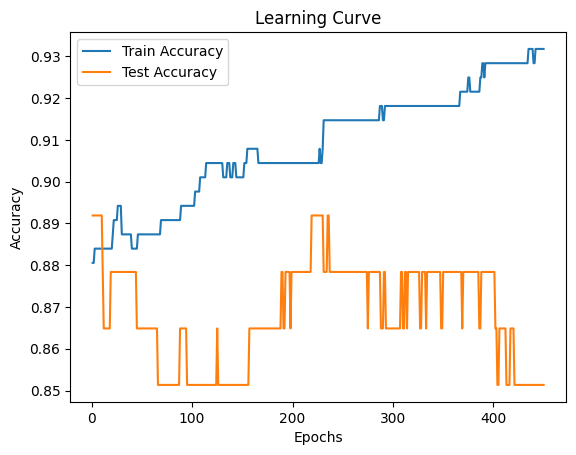

In [ ]:
train_accuracy = []
test_accuracy = []

for epoch in range(1, 451):
    mlp.partial_fit(X_train, y_train, classes=np.unique(y_train))
    y_train_pred = mlp.predict(X_train)
    y_test_pred = mlp.predict(X_test)
    train_accuracy.append(accuracy_score(y_train, y_train_pred))
    test_accuracy.append(accuracy_score(y_test, y_test_pred))

plt.plot(range(1, 451), train_accuracy, label='Train Accuracy')
plt.plot(range(1, 451), test_accuracy, label='Test Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.title('Learning Curve')
plt.legend()
plt.show()

It seems that after 200 or so epochs, the accuracy does not increase, but on the other hand, the accuracy of the training data does increase, so the overfitting is getting bigger and bigger.

####**Neural network with tensorflow**



Neural networks, also known as artificial neural networks (ANNs), are a class of machine learning models inspired by the structure and functioning of the human brain. They have proven to be incredibly powerful tools for solving a wide range of complex tasks, including pattern recognition, image and speech recognition, natural language processing, and more.

We will use a front feed grid. where each layer feeds the next layer.
At the beginning random values are set as the weights but they go through a learning process until they adjust themselves to the ideal weights.

We Define the neural network model

In [ ]:
model = Sequential()
model.add(Dense(5, activation='relu', input_shape=(X_train.shape[1],)))
model.add(Dense(16, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(2, activation='softmax'))

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

history = model.fit(X_train, y_train, epochs=150, validation_data=(X_test, y_test), shuffle = True)

loss, accuracy = model.evaluate(X_test, y_test, verbose=0)
print(f'Test Accuracy: {accuracy*100:.2f}%')

Epoch 1/150
10/10 [==============================] - 1s 34ms/step - loss: 0.6970 - accuracy: 0.5290 - val_loss: 0.6921 - val_accuracy: 0.5946
Epoch 2/150
10/10 [==============================] - 0s 9ms/step - loss: 0.6717 - accuracy: 0.6075 - val_loss: 0.6788 - val_accuracy: 0.5946
Epoch 3/150
10/10 [==============================] - 0s 6ms/step - loss: 0.6540 - accuracy: 0.6212 - val_loss: 0.6669 - val_accuracy: 0.5946
Epoch 4/150
10/10 [==============================] - 0s 8ms/step - loss: 0.6393 - accuracy: 0.6246 - val_loss: 0.6591 - val_accuracy: 0.5946
Epoch 5/150
10/10 [==============================] - 0s 8ms/step - loss: 0.6278 - accuracy: 0.6451 - val_loss: 0.6521 - val_accuracy: 0.6081
Epoch 6/150
10/10 [==============================] - 0s 5ms/step - loss: 0.6176 - accuracy: 0.6587 - val_loss: 0.6449 - val_accuracy: 0.6081
Epoch 7/150
10/10 [==============================] - 0s 6ms/step - loss: 0.6078 - accuracy: 0.6758 - val_loss: 0.6398 - val_accuracy: 0.6216
Epoch 8/150


In [ ]:
loss, accuracy = model.evaluate(X_test, y_test, verbose=0)
print(f'Test Accuracy: {accuracy*100:.2f}%')

Test Accuracy: 86.49%


We got pretty high accuracy. We would like to check if there is overfitting that reduces the accuracy of the test data. We will examine whether we have over-fitting. One of the signs of overfitting is that the training accuracy improves while the validation accuracy starts to decrease. We will examine this in the visualization of Plot training and validation accuracy over the epochs.

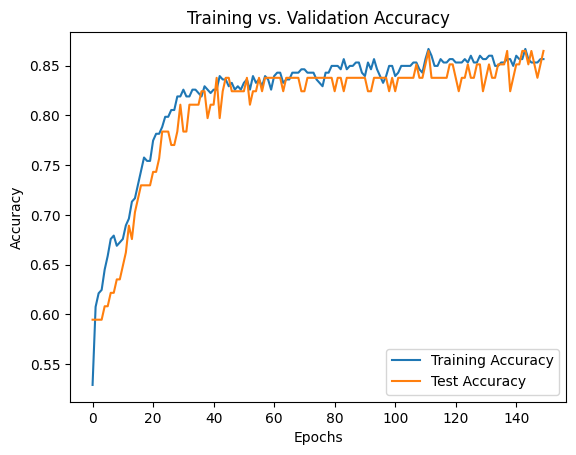

In [ ]:
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Test Accuracy')
plt.legend()
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.title('Training vs. Validation Accuracy')
plt.show()

It can be seen in the simulation that there is almost no overfitting. The 2 accuracies are very close and usually the training accuracy only slightly exceeds the accuracy of the test data. We will try to reduce the adjustment anyway.

It can be seen in the visualization that immediately after the first few epochs the accuracy of the training data increases significantly over the accuracy of the test data. which indicates an adjustment in favor of the training data. This means that there is a problematic overfitting.

We will combine early stopping with regularization techniques in neural networks. Early stopping and regulation are strategies to prevent overfitting, but they work in slightly different ways and can effectively complement each other.

Early stop monitors the validation loss during training and stops training when the loss starts to increase or does not improve for a specified number of epochs. This helps prevent overfitting by stopping training before the model overfits the training data.

Regularization techniques, (we'll use L1, L2) add constraints to the model's weights or architecture to prevent them from fitting the training data too closely.

By combining the two we get a double protection against over-fitting: early stop and regulation act as two lines of defense against over-fitting. Early stopping stops training if the model's validation performance drops, while serialization ensures that the model is less prone to overfitting from the start.

In [ ]:
model = Sequential()
model.add(Dense(5, activation='relu', kernel_regularizer=l2(0.01), input_shape=(X_train.shape[1],)))
model.add(Dense(8, activation='relu', kernel_regularizer=l1(0.01)))
model.add(Dense(8, activation='relu', kernel_regularizer=l1(0.01)))
model.add(Dense(2, activation='softmax'))

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

early_stopping = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)

# Training the model with early stopping and L2/L1 regularization
history = model.fit(X_train, y_train, epochs=500, validation_data=(X_test, y_test), callbacks=[early_stopping], shuffle = True)

Epoch 1/500
10/10 [==============================] - 1s 24ms/step - loss: 1.1146 - accuracy: 0.5256 - val_loss: 1.1258 - val_accuracy: 0.4730
Epoch 2/500
10/10 [==============================] - 0s 8ms/step - loss: 1.0960 - accuracy: 0.5358 - val_loss: 1.1086 - val_accuracy: 0.4865
Epoch 3/500
10/10 [==============================] - 0s 6ms/step - loss: 1.0822 - accuracy: 0.5358 - val_loss: 1.0948 - val_accuracy: 0.4865
Epoch 4/500
10/10 [==============================] - 0s 8ms/step - loss: 1.0708 - accuracy: 0.5222 - val_loss: 1.0821 - val_accuracy: 0.4730
Epoch 5/500
10/10 [==============================] - 0s 7ms/step - loss: 1.0604 - accuracy: 0.5358 - val_loss: 1.0723 - val_accuracy: 0.4730
Epoch 6/500
10/10 [==============================] - 0s 7ms/step - loss: 1.0510 - accuracy: 0.5324 - val_loss: 1.0628 - val_accuracy: 0.4595
Epoch 7/500
10/10 [==============================] - 0s 7ms/step - loss: 1.0417 - accuracy: 0.5256 - val_loss: 1.0534 - val_accuracy: 0.4730
Epoch 8/500


In [ ]:
# Evaluate the model on the test set
loss, accuracy = model.evaluate(X_test, y_test, verbose=0)
print(f'Test Accuracy: {accuracy*100:.2f}%')
print("Test Loss:", loss)

Test Accuracy: 87.84%
Test Loss: 0.43446704745292664


We got higher accuracy. But we would still like to check what about overfitting. For this purpose, we will once again present a simulation of the accuracy.

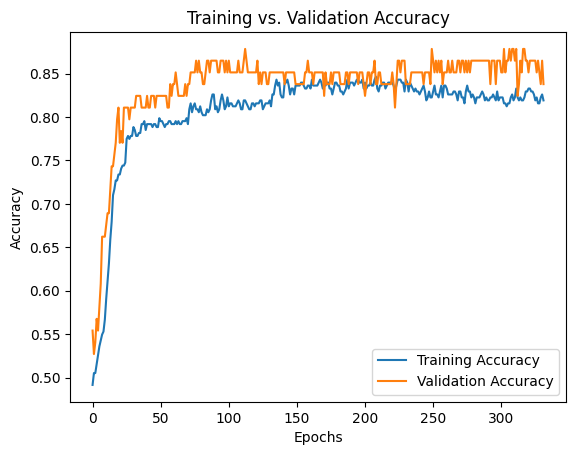

In [ ]:
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.legend()
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.title('Training vs. Validation Accuracy')
plt.show()

Wow!. Amazing. It seems that there is no overfitting rule all the time the orange graph that represents the accuracy of the test data over the accuracy of the training.
It appears that indeed early stopping and regularization techniques reduced overfitting.

#####Training and Validation Loss and Accuracy Over Epochs:

In [ ]:
fig = make_subplots(rows=1, cols=2, subplot_titles=('Loss', 'Accuracy'))

# Add loss traces
fig.add_trace(go.Scatter(x=list(range(1, len(history.history['loss'])+1)), y=history.history['loss'], mode='lines', name='Training Loss'), row=1, col=1)
fig.add_trace(go.Scatter(x=list(range(1, len(history.history['val_loss'])+1)), y=history.history['val_loss'], mode='lines', name='Validation Loss'), row=1, col=1)

# Add accuracy traces
fig.add_trace(go.Scatter(x=list(range(1, len(history.history['accuracy'])+1)), y=history.history['accuracy'], mode='lines', name='Training Accuracy'), row=1, col=2)
fig.add_trace(go.Scatter(x=list(range(1, len(history.history['val_accuracy'])+1)), y=history.history['val_accuracy'], mode='lines', name='Validation Accuracy'), row=1, col=2)

fig.update_layout(title='Training History')
fig.show()

Here you can see that the results for the test data are better in all respects.
They are exactly where the test data got a better result. and in the loss function - the test data loss is smaller than the training loss.

#####ROC Curve and AUC

3/3 [==============================] - 0s 3ms/step


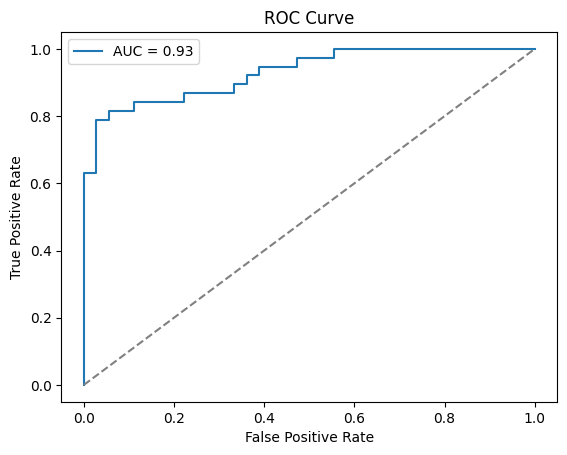

In [ ]:
y_pred = model.predict(X_test)

fpr, tpr, thresholds = roc_curve(y_test, y_pred[:, 1])

auc = roc_auc_score(y_test, y_pred[:, 1])

plt.plot(fpr, tpr, label=f'AUC = {auc:.2f}')
plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend()
plt.show()

Our ROC curve appears as "steps" instead of a smooth and continuous curve because we have a limited number of distinct threshold values for the model's prediction. We have a number of attributes that are not continuous but have a small number of discrete and limited values. For example, its M/F feature has only 2 possibilities Male and female.

Our ROC curve is far from the diagonal line, which shows that the discriminative power of the model is very good. Our AUC value is 0.93 and it indicates good diagnosis and performance of the model.

#####Confusion matrix

3/3 [==============================] - 0s 3ms/step


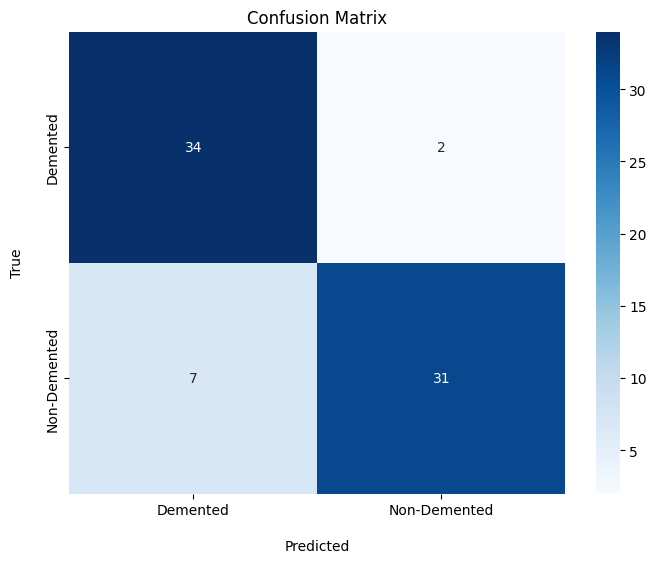

In [ ]:
# Define department names
department_names = ['Demented', 'Non-Demented']

y_pred = model.predict(X_test)
y_pred_labels = np.argmax(y_pred, axis=1)

cm = confusion_matrix(y_test, y_pred_labels)

plt.figure(figsize=(4, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=department_names, yticklabels=department_names)
plt.xlabel('\nPredicted')
plt.ylabel('True\n')
plt.title('Confusion Matrix')
plt.show()

We see 7 observations are FP and 2 observations TN. A total of 9 errors.

We would like to find out where he failed and why precisely in these observations. The first thing is to find out which observations were misclassified.

In [ ]:
misclassified_tf_df = pd.DataFrame({
    'index': X_test.index,
    'True_Label': y_test,
    'Predicted_Label': y_pred_labels
})

# Filter out the misclassified instances
misclassified_tf_df = misclassified_tf_df[misclassified_tf_df['True_Label'] != misclassified_tf_df['Predicted_Label']]
misclassified_tf_df.reset_index(drop=True, inplace=True)
print("Misclassified Instances:")
misclassified_tf_df

Misclassified Instances:


,index,True_Label,Predicted_Label
0,33,1,0
1,57,1,0
2,344,0,1
3,333,1,0
4,109,1,0
5,277,1,0
6,339,1,0
7,93,0,1
8,73,1,0


We received 9 observations.

We would like to get the values of the features after normalization (those on which the training was actually done): misclassified_tf_df.



In [ ]:
misclassified_tf_df = pd.merge(best_features_df, misclassified_tf_df, left_index=True, right_on='index')
misclassified_tf_df.drop(['Group'], axis=1, inplace=True)
misclassified_tf_df

,M/F,MMSE,SES,EDUC,eTIV,index,True_Label,Predicted_Label
0,-0.855063,0.753265,-1.301954,-0.245368,-0.475286,33,1,0
1,-0.855063,0.753265,0.525263,-0.968661,-0.338183,57,1,0
8,1.169505,0.450805,1.438871,-0.968661,-0.012562,73,1,0
7,-0.855063,-0.154114,-0.388346,0.477926,-0.429585,93,0,1
4,-0.855063,0.450805,-1.301954,1.201219,-1.286482,109,1,0
5,-0.855063,0.450805,-1.301954,0.477926,-0.869459,277,1,0
3,1.169505,0.450805,-1.301954,0.477926,2.341050,333,1,0
6,1.169505,0.148345,1.438871,0.477926,1.792635,339,1,0
2,1.169505,0.148345,0.525263,-0.245368,0.118829,344,0,1


We will use the SHAP library to check what the most important features are in this model. The features that are responsible for this performance. We received in the following drawing that MMSE is in first place followed by eTIV.

We have already seen these features come to mind already during the EDA stages and also during the analysis of the results of the other algorithms.

10/10 [==============================] - 0s 2ms/step


  0%|          | 0/74 [00:00<?, ?it/s]

275/275 [==============================] - 1s 3ms/step


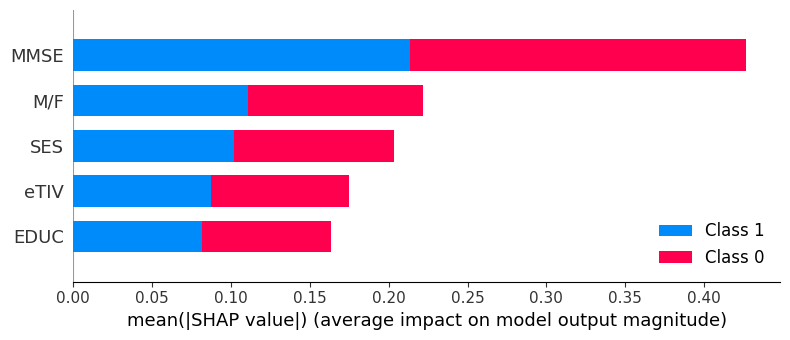

In [ ]:
explainer = shap.KernelExplainer(model.predict, X_train, verbose=0)
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, X_test);

So far this is the best result we have received.

####**Summary**

The **Regression** model gave us an accuracy of 78 percent. We saw that there was no serious overfitting, so it is likely that the problem is that the model does not fit the data or the data itself. A logistic regression model assumes that there is a linear relationship between the attributes and the logistic probabilities of the target variable. If the true relationship is not linear, logistic regression may struggle to capture it. We hypothesize that this model is too simple for our data, so we will use more complex models.

The **XGBoost** model gives us an accuracy of 86 percent. At first we got an accuracy of 85 percent and we saw that there was a very high overfitting. We tried to solve this by reducing the complexity of the model, for that we dropped a feature and tried to run without it and the result improved very slightly (86) and there is still overfitting. The model learns the training data too well. Still, the results are better than regression, probably because the relationship between the features and the target variable is not linear.

The **Random Forest** model gave us an accuracy of 91.89 percent. We have seen that this model gives a lot of weight to the features that have a large part in the misclassifications. Probably the model is learning the data inaccurately or maybe the problem is with the data that are unusual and therefore classified incorrectly. Random Forest Classifier has better performance than XGBoost Classifier because random forests can deal better with noisy and outlier data than XGBoost. And it is also less sensitive to irrelevant features compared to XGBoost. Also its performance is slightly better than neural networks because our data set is relatively small and random forests can manage with relatively small data sets, more than neural networks which often need a larger amount of data to generalize effectively.

The **Neural network with MLPClassifier** model gives us an accuracy of 89 percent. At first it gave an accuracy of 89 percent. Also here as in the previous model from a review of the observations that were misclassified the features that caused this are important features in this model. that the model gave them a lot of weight and therefore it is impossible to lower these features without harming the overall accuracy.

The **Neural network with tensorflow** model gives us an accuracy of 86 percent. By combining early stopping and regularization, we canceled the overfitting and the accuracy increased to 87.84 percent. MLPClassifier gives better results, maybe scikit-learn's MLPClassifier uses a different optimization algorithm so it performs better.

                                                                  ⚛ ⚛ ⚛





Some observations were misclassified by all models. This gives us a red light which is probably noises. Because the models work in a completely different way and if all the models failed them, the problem is probably with the observations and not the models.


7 more observations were misclassified in at least 2 of the models and they are (Observations: 277, 344, 93, 57, 333, 109, 73)

##**Summary**

We chose to run the models on 2 data bases that were extracted from the real base, the first was the model on which PCA was performed. And the second was features that we extracted from the entire information base based on an algorithm that selected the most significant features. We wanted to test both to see which one would give better results. In most models the best_features brought better results by a few percent. When running the models, the maximum accuracy for BEST-FEATURES was 91 percent compared to the maximum accuracy in PCA which gave us 90 percent, this accuracy is not enough to rely only on it. But it is important to remember that during the EDA process we omitted the CDR column, we lowered the values of this test because we saw that the mini-mental test classifies the data too well. That is, there is almost a perfect linear relationship between them. If we didn't omit this feature then we wouldn't have to research and understand the data nor work to get good results from models. That's why we took it down even though we gave up accuracy. But in real life if CDR is used it is possible to achieve much better results and maybe even 100 percent success. And back to our project, we saw that we got results of 91 percent only if the features MMSE, ETIV, EDUC, SES, M/F. In fact, we saw that it is possible to achieve good results only with these features, the other features are not necessary.

Surprisingly, throughout the work on the data and also in the analysis of the models, we were surprised to discover that the cognitive tests (CDR, MMSE) have a higher importance than the MRI details.

We will also pay attention to the interesting phenomenon, that in all the different models FP is significantly smaller than FN. This means that all the models are more accurate in diagnosing demented than in diagnosing non-demented.

And in conclusion, we had a lot of fun exploring this whole interesting topic. Although the results - accuracy is more vague, but this was expected when we downloaded a very significant feature (CDR) in order to make the project more interesting.

Thank you so much for all the help during this project, it helped us a lot.